# Image Captioning

Reference: https://huggingface.co/Salesforce/blip-image-captioning-large

CC0 images from https://isorepublic.com

In [7]:
import requests
from PIL import Image
from transformers import BlipProcessor, BlipForConditionalGeneration
from IPython.display import display
import glob

processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-large")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-large")

In [8]:
def to_raw_image(img_path):
    raw_image = Image.open(img_path).convert('RGB')
    display(raw_image)
    return raw_image
    
def make_caption(raw_image, condition):
    caption = []

    # conditional image captioning
    text = condition
    inputs = processor(raw_image, text, return_tensors="pt")
    
    out = model.generate(**inputs)
    caption.append(processor.decode(out[0], skip_special_tokens=True))
    
    # unconditional image captioning
    inputs = processor(raw_image, return_tensors="pt")
    
    out = model.generate(**inputs)
    caption.append(processor.decode(out[0], skip_special_tokens=True))

    return caption

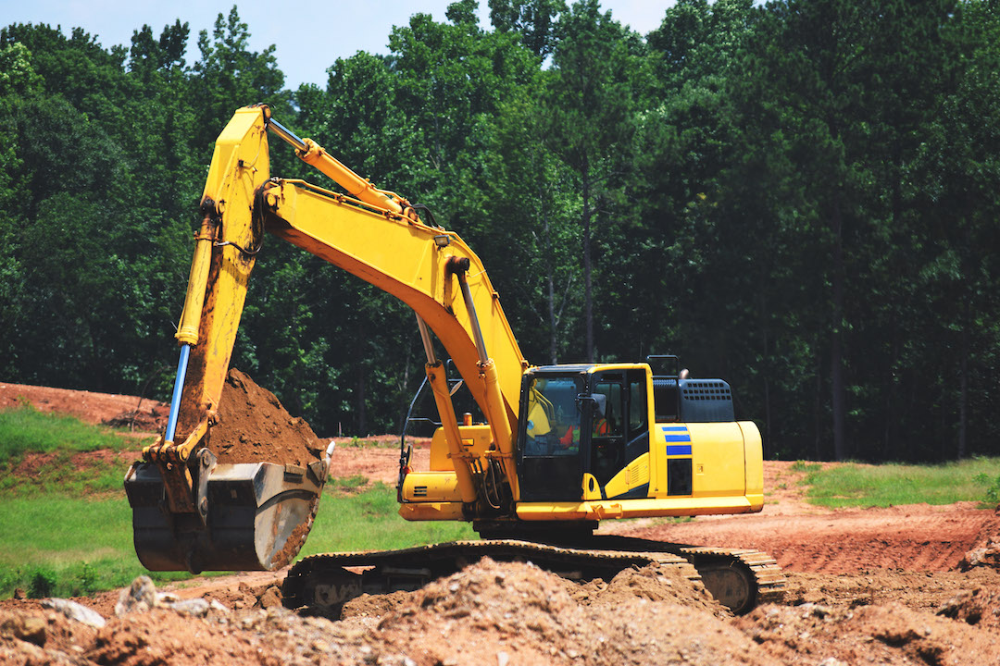

a photo of a yellow excavator is moving dirt on a field
there is a yellow excavator that is on a dirt field





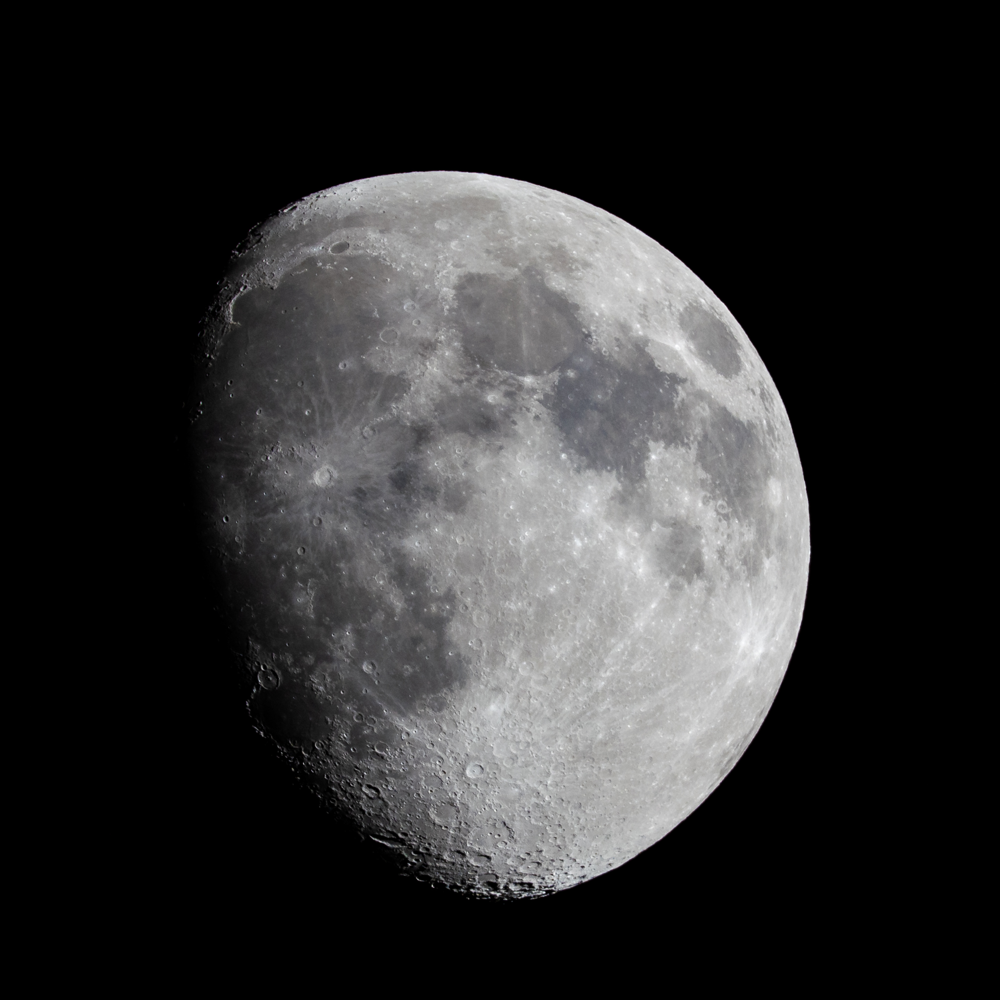

a photo of a close up of a moon with a black background
arafed view of a moon with a black background





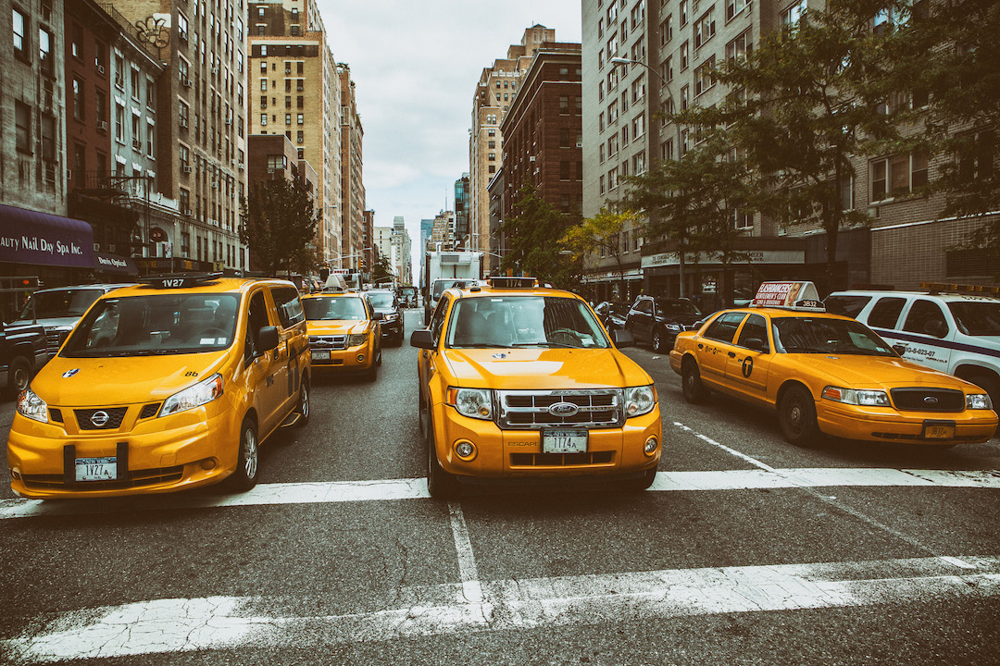

a photo of a group of yellow cabs parked in a parking lot
yellow cabs and cars are parked in a busy city street





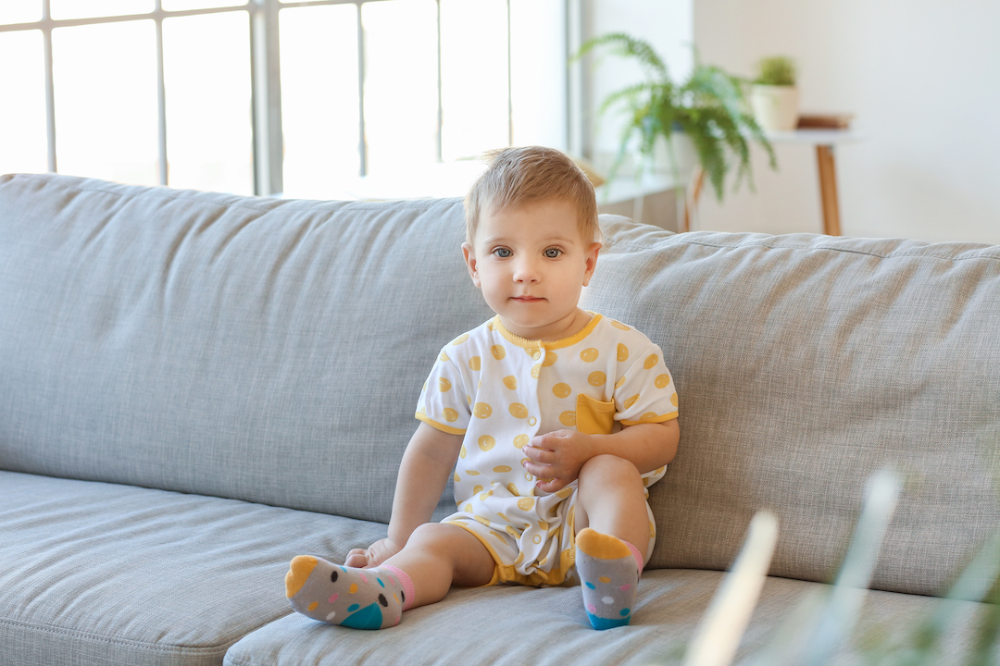

a photo of a little boy sitting on a couch with a remote control
there is a little boy sitting on a couch with a toy





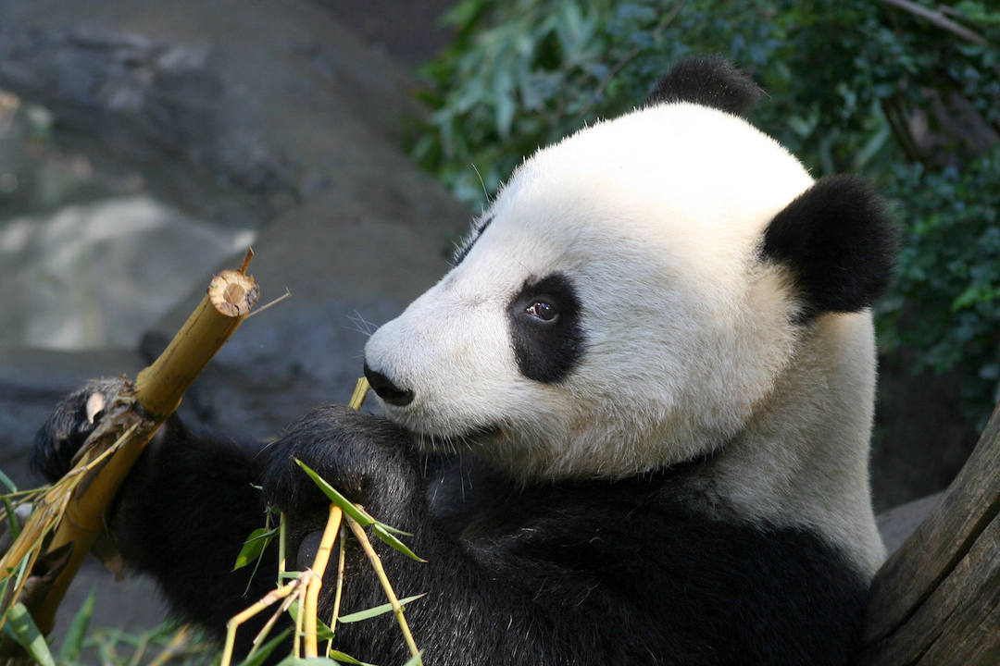

a photo of a panda bear sitting on a tree branch eating bamboo
panda bear sitting on a tree branch eating bamboo in a zoo





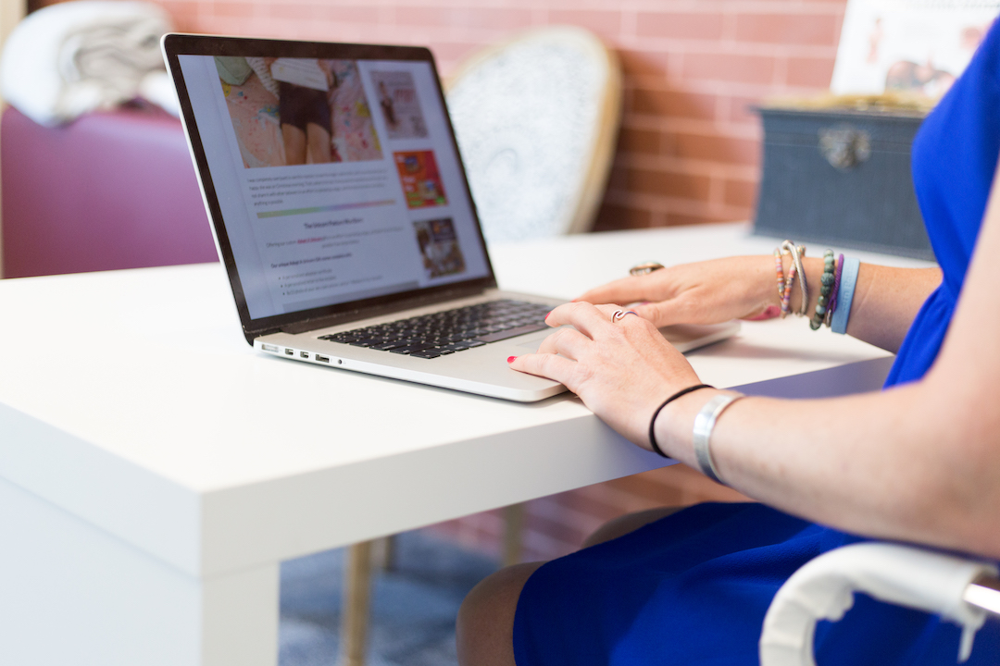

a photo of a woman in a blue dress is typing on a laptop
someone is typing on a laptop on a white table





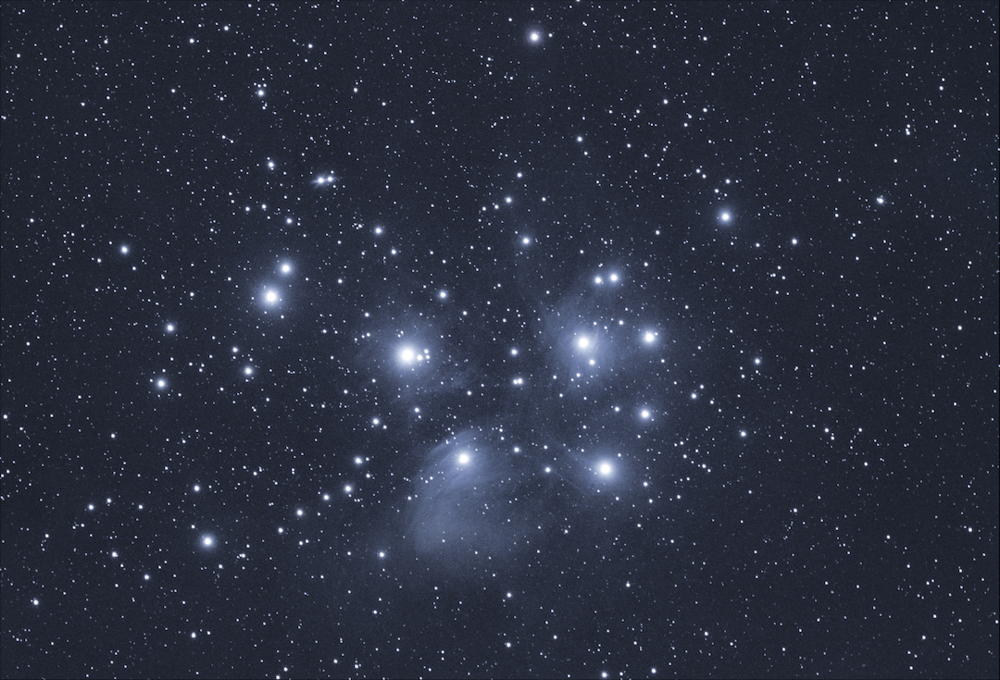

a photo of a cluster of stars in the sky with a black background
there are many stars in the sky with a black background





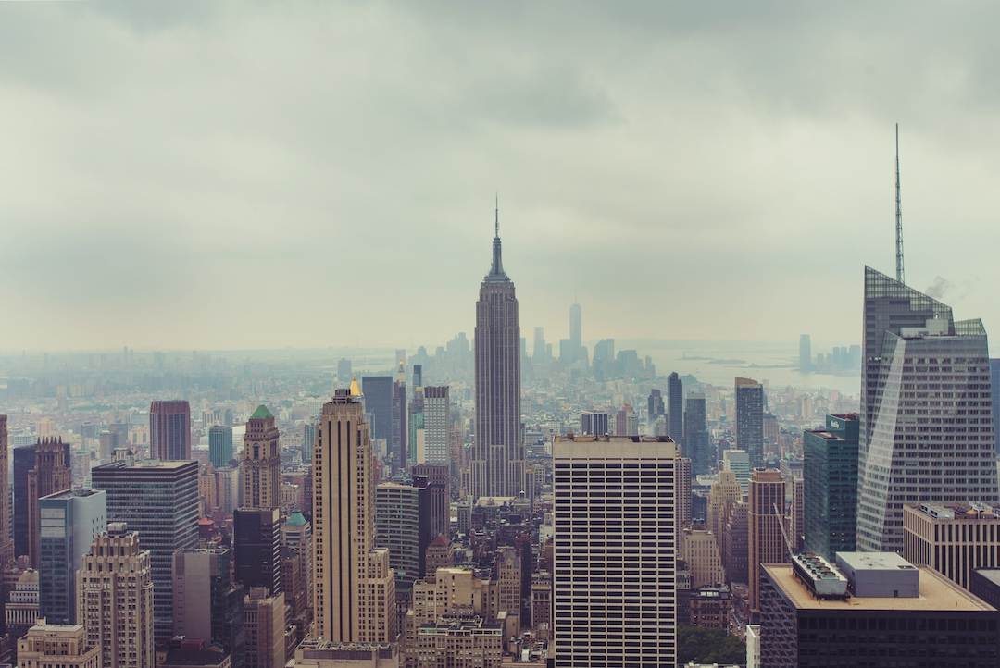

a photo of a city skyline with a few tall buildings
araffature view of a city with skyscrapers and a cloudy sky





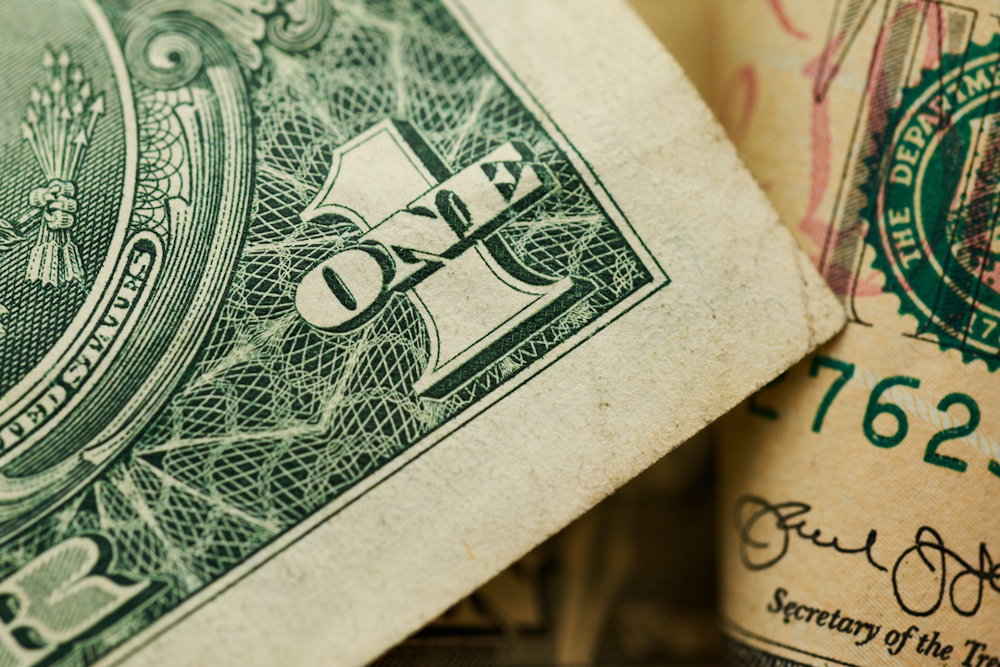

a photo of a close up of a dollar bill with a stamp
there are two bills of one dollar and one dollar bill





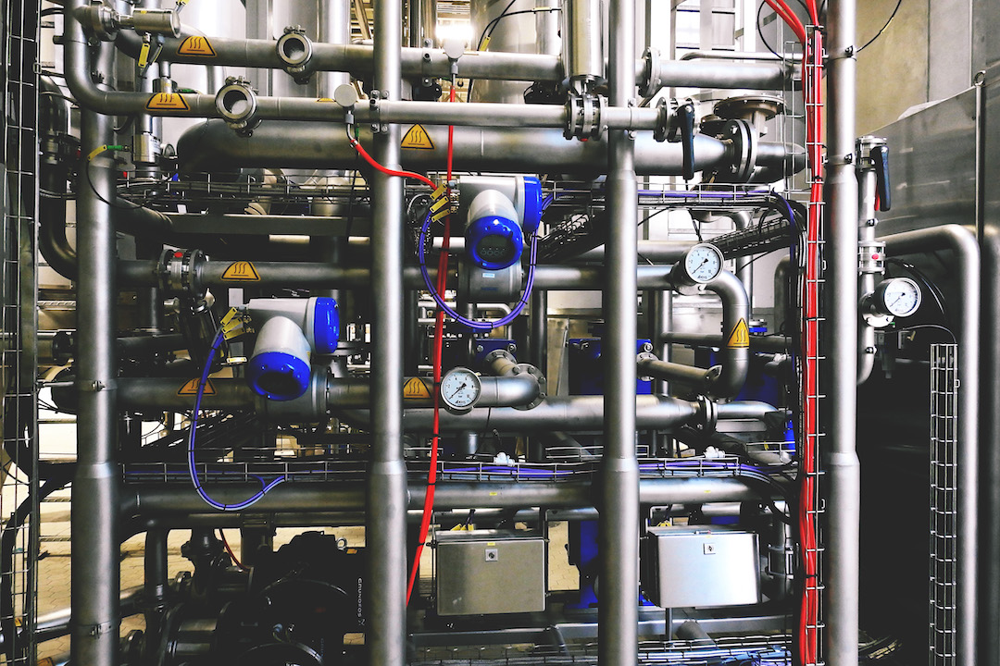

a photo of a bunch of pipes and valves in a building
there are pipes and valves in a large industrial building





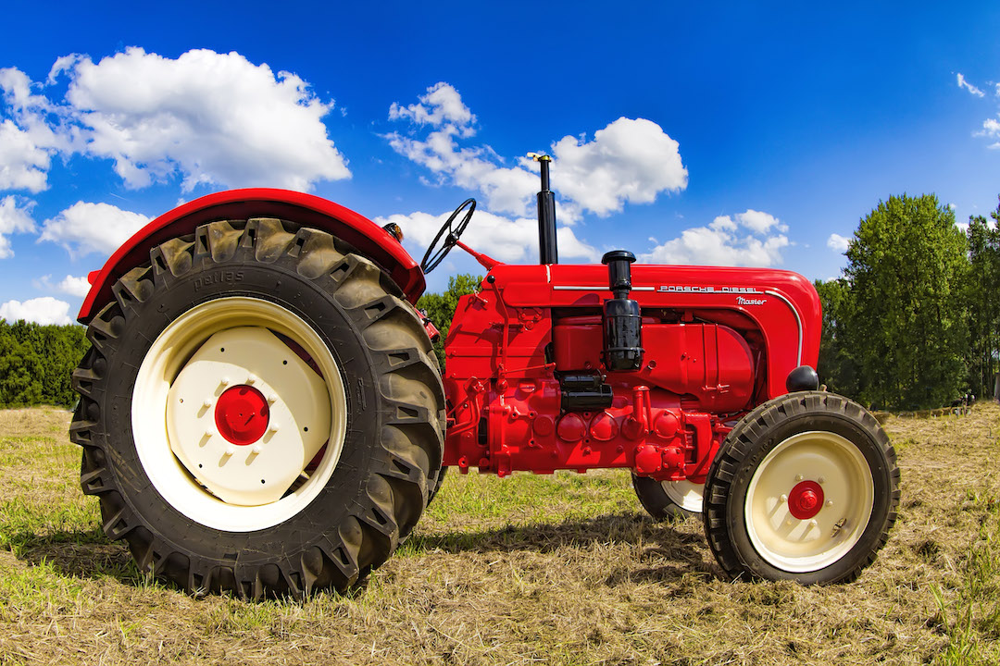

a photo of a red tractor parked in a field with a blue sky
there is a red tractor that is parked in the grass





In [9]:
img_pathes = glob.glob('../data/images/*.jpg')

for path in img_pathes:
    raw_image = to_raw_image(path)
    caption = make_caption(raw_image, condition='A photo of')
    for c in caption:
        print(c)
    print(end='\n\n\n')